In [1]:
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from CinePred.data.data import *


In [2]:
print('----- init Data -----')
data = Data('../raw_data/IMDb movies.csv')

print('----- import Data -----')
data.import_data()

print('----- keep columns -----')
data.keep_columns(columns_names=[
    'imdb_title_id', 'title', 'year', 'date_published', 'genre',
    'duration', 'country', 'director', 'writer', 'production_company',
    'actors', 'budget', 'worlwide_gross_income'
])

print('----- remove na rows -----')
data.remove_na_rows()

print('----- convert budget -----')
data.convert_budget_column(column_name='budget',min_rows=45, out_currency='USD')
print('----- filter categories -----')
data.filter_categories("actors", nb=2)

print('----- convert income column -----')
data.convert_income(column_name='worlwide_gross_income')

print('----- one hot encode -----')
#data.one_hot_encode(column_names=['director','genre'])
#data.one_hot_encode(column_names=['genre'])
#data.one_hot_encode(column_names=['director'])

print('----- convert to int -----')
data.convert_to_int('year')
data.convert_to_int('duration')

print('----- convert to date -----')
data.convert_to_date('date_published')

print('----- seasonality Sin/Cos -----')
data.add_sin_cos_features('Month_published')

print('----- categorize production company -----')
data.add_prod_company_category("production_company", "production_weight")

print('----- reset index -----')
data.reset_index()

print('----- data_shape -----')
print(data.dataframe.shape)


----- init Data -----
----- import Data -----
----- keep columns -----
----- remove na rows -----
----- convert budget -----
----- filter categories -----
----- convert income column -----
----- one hot encode -----
----- convert to int -----
----- convert to date -----
----- seasonality Sin/Cos -----
----- categorize production company -----
----- reset index -----
----- data_shape -----
(12024, 17)


In [3]:
data.dataframe.head()

,imdb_title_id,title,year,date_published,genre,duration,country,director,writer,production_company,actors,budget,worlwide_gross_income,Month_published,sin_MoPub,cos_MoPub,production_weight
0,tt0010323,Il gabinetto del dottor Caligari,1920,1920-02-27,"Fantasy, Horror, Mystery",76,Germany,Robert Wiene,"Carl Mayer, Hans Janowitz",Decla-Bioscop AG,"Werner Krauss, Conrad Veidt",18000.000000,8811,2,8.660254e-01,0.500000,1
1,tt0011440,Markens grøde,1921,1921-12-02,Drama,107,Norway,Gunnar Sommerfeldt,"Knut Hamsun, Gunnar Sommerfeldt",Christiana Film,"Amund Rydland, Karen Poulsen",29262.742718,4272,12,-2.449294e-16,1.000000,1
2,tt0012190,I quattro cavalieri dell'Apocalisse,1921,1923-04-16,"Drama, Romance, War",150,USA,Rex Ingram,"Vicente Blasco Ibáñez, June Mathis",Metro Pictures Corporation,"Pomeroy Cannon, Josef Swickard",800000.000000,9183673,4,8.660254e-01,-0.500000,1
3,tt0012349,Il monello,1921,1923-11-26,"Comedy, Drama, Family",68,USA,Charles Chaplin,Charles Chaplin,Charles Chaplin Productions,"Carl Miller, Edna Purviance",250000.000000,26916,11,-5.000000e-01,0.866025,3
4,tt0014624,La donna di Parigi,1923,1927-06-06,"Drama, Romance",82,USA,Charles Chaplin,Charles Chaplin,Charles Chaplin Productions,"Edna Purviance, Clarence Geldart",351000.000000,11233,6,1.224647e-16,-1.000000,3


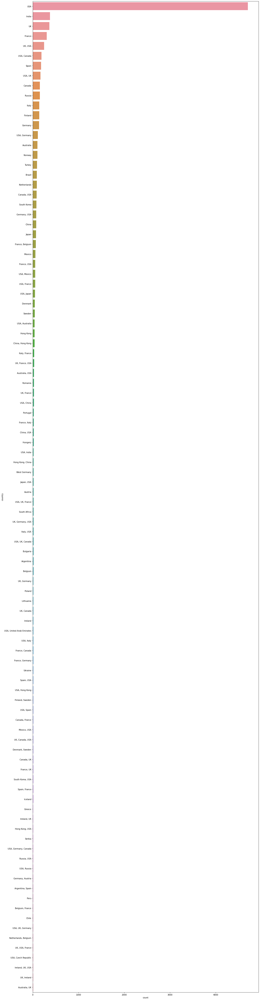

In [4]:
plt.figure(figsize=(20,90))

ax = sns.countplot(y="country", data=data.dataframe, order=data.dataframe['country'].value_counts().index[0:100])

In [5]:
pd.set_option('display.max_rows', data.dataframe.shape[0]+1)

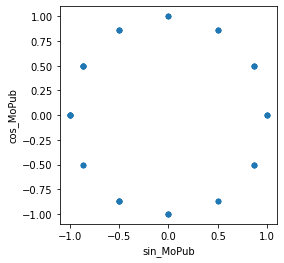

In [6]:
data.dataframe.sample(100).plot.scatter("sin_MoPub","cos_MoPub").set_aspect('equal');

##### data.dataframe["production_company"].value_counts()

In [7]:
prod = pd.cut(data.dataframe['production_company'].value_counts(), bins=[0,1,5,20,50,500], include_lowest=True, labels=[1,2,3,4,5])

In [8]:
data.dataframe["production_weight"] = data.dataframe["production_company"].map(lambda x: prod[str(x)])

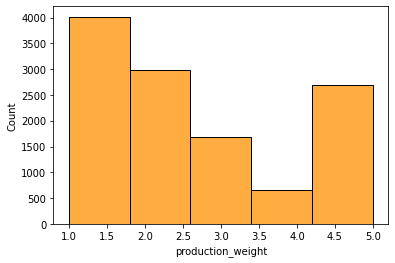

In [9]:
sns.histplot(data.dataframe["production_weight"], bins = 5, color = "#ff9000");

In [10]:
data.dataframe["writer"].value_counts()

Woody Allen                                                35
John Hughes                                                15
Joel Coen, Ethan Coen                                      13
John Sayles                                                12
M. Night Shyamalan                                         11
Kevin Smith                                                11
Luc Besson                                                 10
Luc Besson, Robert Mark Kamen                              10
Rainer Werner Fassbinder                                    9
Jon Lucas, Scott Moore                                      9
Patrick Melton, Marcus Dunstan                              8
Jason Friedberg, Aaron Seltzer                              8
Lilly Wachowski, Lana Wachowski                             8
Christopher Markus, Stephen McFeely                         8
Steven Knight                                               7
Joe Eszterhas                                               7
Jonathan

In [11]:
df = data.dataframe

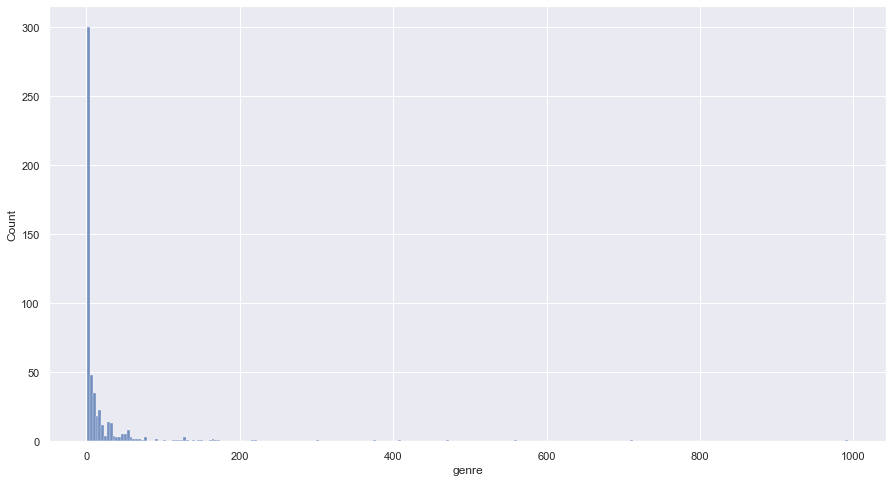

In [12]:
from scipy import stats
sns.set(rc={'figure.figsize':(15,8)})

column_to_plot = 'genre'
df_toplot = pd.DataFrame(df[column_to_plot].value_counts().reset_index())
#sns.barplot(x=df_toplot['index'],y=df_toplot[column_to_plot]);
sns.histplot(df_toplot[column_to_plot]);

In [13]:
data.dataframe["writer"].value_counts()

Woody Allen                                                35
John Hughes                                                15
Joel Coen, Ethan Coen                                      13
John Sayles                                                12
M. Night Shyamalan                                         11
Kevin Smith                                                11
Luc Besson                                                 10
Luc Besson, Robert Mark Kamen                              10
Rainer Werner Fassbinder                                    9
Jon Lucas, Scott Moore                                      9
Patrick Melton, Marcus Dunstan                              8
Jason Friedberg, Aaron Seltzer                              8
Lilly Wachowski, Lana Wachowski                             8
Christopher Markus, Stephen McFeely                         8
Steven Knight                                               7
Joe Eszterhas                                               7
Jonathan

In [14]:
cat_dir = pd.cut(data.dataframe['writer'].value_counts(), bins=[0,1,5,40], include_lowest=True, labels=[1,2,3])

In [15]:
data.dataframe["writer_weight"] = data.dataframe["writer"].map(lambda x: cat_dir[str(x)])

In [16]:
data.dataframe.head()

,imdb_title_id,title,year,date_published,genre,duration,country,director,writer,production_company,actors,budget,worlwide_gross_income,Month_published,sin_MoPub,cos_MoPub,production_weight,writer_weight
0,tt0010323,Il gabinetto del dottor Caligari,1920,1920-02-27,"Fantasy, Horror, Mystery",76,Germany,Robert Wiene,"Carl Mayer, Hans Janowitz",Decla-Bioscop AG,"Werner Krauss, Conrad Veidt",18000.000000,8811,2,8.660254e-01,0.500000,1,1
1,tt0011440,Markens grøde,1921,1921-12-02,Drama,107,Norway,Gunnar Sommerfeldt,"Knut Hamsun, Gunnar Sommerfeldt",Christiana Film,"Amund Rydland, Karen Poulsen",29262.742718,4272,12,-2.449294e-16,1.000000,1,1
2,tt0012190,I quattro cavalieri dell'Apocalisse,1921,1923-04-16,"Drama, Romance, War",150,USA,Rex Ingram,"Vicente Blasco Ibáñez, June Mathis",Metro Pictures Corporation,"Pomeroy Cannon, Josef Swickard",800000.000000,9183673,4,8.660254e-01,-0.500000,1,1
3,tt0012349,Il monello,1921,1923-11-26,"Comedy, Drama, Family",68,USA,Charles Chaplin,Charles Chaplin,Charles Chaplin Productions,"Carl Miller, Edna Purviance",250000.000000,26916,11,-5.000000e-01,0.866025,3,3
4,tt0014624,La donna di Parigi,1923,1927-06-06,"Drama, Romance",82,USA,Charles Chaplin,Charles Chaplin,Charles Chaplin Productions,"Edna Purviance, Clarence Geldart",351000.000000,11233,6,1.224647e-16,-1.000000,3,3


In [17]:
data.dataframe["production_company"].nunique()

5358

In [18]:
data.dataframe["writer_weight"].value_counts()

1    9329
2    2361
3     334
Name: writer_weight, dtype: int64

In [19]:
data.dataframe["genre"].value_counts()

Drama                              993
Comedy                             711
Comedy, Drama                      558
Comedy, Drama, Romance             473
Drama, Romance                     410
Comedy, Romance                    375
Action, Crime, Drama               302
Crime, Drama, Thriller             221
Animation, Adventure, Comedy       216
Crime, Drama, Mystery              172
Horror, Thriller                   168
Drama, Thriller                    165
Action, Adventure, Comedy          164
Action, Comedy, Crime              161
Crime, Drama                       151
Action, Adventure, Sci-Fi          148
Action, Crime, Thriller            139
Action, Adventure, Drama           131
Horror, Mystery, Thriller          130
Action, Thriller                   128
Biography, Drama, History          127
Horror                             123
Comedy, Crime, Drama               122
Biography, Drama                   117
Action, Adventure, Fantasy         113
Comedy, Crime            

In [20]:
#data.dataframe["log_budget"] = np.log(data.dataframe["budget"])

In [21]:
data.dataframe.head(2)

,imdb_title_id,title,year,date_published,genre,duration,country,director,writer,production_company,actors,budget,worlwide_gross_income,Month_published,sin_MoPub,cos_MoPub,production_weight,writer_weight
0,tt0010323,Il gabinetto del dottor Caligari,1920,1920-02-27,"Fantasy, Horror, Mystery",76,Germany,Robert Wiene,"Carl Mayer, Hans Janowitz",Decla-Bioscop AG,"Werner Krauss, Conrad Veidt",18000.000000,8811,2,8.660254e-01,0.5,1,1
1,tt0011440,Markens grøde,1921,1921-12-02,Drama,107,Norway,Gunnar Sommerfeldt,"Knut Hamsun, Gunnar Sommerfeldt",Christiana Film,"Amund Rydland, Karen Poulsen",29262.742718,4272,12,-2.449294e-16,1.0,1,1


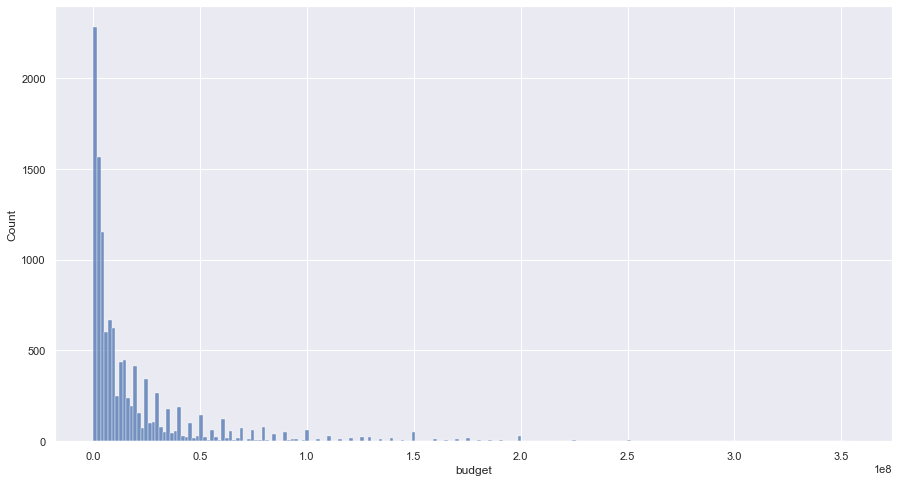

In [22]:
sns.histplot(data.dataframe["budget"]);

In [23]:
#sns.histplot(data.dataframe["log_budget"]);

In [24]:
data.dataframe.head(3)

,imdb_title_id,title,year,date_published,genre,duration,country,director,writer,production_company,actors,budget,worlwide_gross_income,Month_published,sin_MoPub,cos_MoPub,production_weight,writer_weight
0,tt0010323,Il gabinetto del dottor Caligari,1920,1920-02-27,"Fantasy, Horror, Mystery",76,Germany,Robert Wiene,"Carl Mayer, Hans Janowitz",Decla-Bioscop AG,"Werner Krauss, Conrad Veidt",18000.000000,8811,2,8.660254e-01,0.5,1,1
1,tt0011440,Markens grøde,1921,1921-12-02,Drama,107,Norway,Gunnar Sommerfeldt,"Knut Hamsun, Gunnar Sommerfeldt",Christiana Film,"Amund Rydland, Karen Poulsen",29262.742718,4272,12,-2.449294e-16,1.0,1,1
2,tt0012190,I quattro cavalieri dell'Apocalisse,1921,1923-04-16,"Drama, Romance, War",150,USA,Rex Ingram,"Vicente Blasco Ibáñez, June Mathis",Metro Pictures Corporation,"Pomeroy Cannon, Josef Swickard",800000.000000,9183673,4,8.660254e-01,-0.5,1,1


In [25]:
def log_transformation(data,column_name): 
    data.dataframe[f"log_{column_name}"] = np.log(data.dataframe[column_name])
    
    return data

In [26]:
log_transformation(data,"budget");

/Users/scottlichtenstein/.pyenv/versions/3.8.12/envs/cinepred/lib/python3.8/site-packages/pandas/core/arraylike.py:364: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [27]:
data.dataframe

,imdb_title_id,title,year,date_published,genre,duration,country,director,writer,production_company,actors,budget,worlwide_gross_income,Month_published,sin_MoPub,cos_MoPub,production_weight,writer_weight,log_budget
0,tt0010323,Il gabinetto del dottor Caligari,1920,1920-02-27,"Fantasy, Horror, Mystery",76,Germany,Robert Wiene,"Carl Mayer, Hans Janowitz",Decla-Bioscop AG,"Werner Krauss, Conrad Veidt",1.800000e+04,8811,2,8.660254e-01,5.000000e-01,1,1,9.798127
1,tt0011440,Markens grøde,1921,1921-12-02,Drama,107,Norway,Gunnar Sommerfeldt,"Knut Hamsun, Gunnar Sommerfeldt",Christiana Film,"Amund Rydland, Karen Poulsen",2.926274e+04,4272,12,-2.449294e-16,1.000000e+00,1,1,10.284070
2,tt0012190,I quattro cavalieri dell'Apocalisse,1921,1923-04-16,"Drama, Romance, War",150,USA,Rex Ingram,"Vicente Blasco Ibáñez, June Mathis",Metro Pictures Corporation,"Pomeroy Cannon, Josef Swickard",8.000000e+05,9183673,4,8.660254e-01,-5.000000e-01,1,1,13.592367
3,tt0012349,Il monello,1921,1923-11-26,"Comedy, Drama, Family",68,USA,Charles Chaplin,Charles Chaplin,Charles Chaplin Productions,"Carl Miller, Edna Purviance",2.500000e+05,26916,11,-5.000000e-01,8.660254e-01,3,3,12.429216
4,tt0014624,La donna di Parigi,1923,1927-06-06,"Drama, Romance",82,USA,Charles Chaplin,Charles Chaplin,Charles Chaplin Productions,"Edna Purviance, Clarence Geldart",3.510000e+05,11233,6,1.224647e-16,-1.000000e+00,3,3,12.768542
5,tt0015864,La febbre dell'oro,1925,1925-10-23,"Adventure, Comedy, Drama",95,USA,Charles Chaplin,Charles Chaplin,Charles Chaplin Productions,"Charles Chaplin, Mack Swain",9.230000e+05,26916,10,-8.660254e-01,5.000000e-01,3,3,13.735385
6,tt0017075,Il pensionante,1927,1927-02-14,"Crime, Drama, Mystery",68,UK,Alfred Hitchcock,"Marie Belloc Lowndes, Eliot Stannard",Gainsborough Pictures,"Marie Ault, Arthur Chesney",1.636325e+04,83260,2,8.660254e-01,5.000000e-01,1,1,9.702793
7,tt0017136,Metropolis,1927,1928-10-01,"Drama, Sci-Fi",153,Germany,Fritz Lang,"Thea von Harbou, Thea von Harbou",Universum Film (UFA),"Alfred Abel, Gustav Fröhlich",3.456000e+06,1349711,10,-8.660254e-01,5.000000e-01,1,1,15.055622
8,tt0018192,Napoleone,1927,1927-04-07,"Biography, Drama, History",240,France,Abel Gance,Abel Gance,Ciné France,"Albert Dieudonné, Vladimir Roudenko",3.440000e+06,39448,4,8.660254e-01,-5.000000e-01,1,1,15.050982
9,tt0018455,Aurora,1927,1928-03-31,"Drama, Romance",94,USA,F.W. Murnau,"Carl Mayer, Hermann Sudermann",Fox Film Corporation,"George O'Brien, Janet Gaynor",2.000000e+05,121107,3,1.000000e+00,6.123234e-17,1,1,12.206073


In [28]:
data.dataframe[data.dataframe['title'].str.contains("Wars")]

,imdb_title_id,title,year,date_published,genre,duration,country,director,writer,production_company,actors,budget,worlwide_gross_income,Month_published,sin_MoPub,cos_MoPub,production_weight,writer_weight,log_budget
2783,tt0120915,Star Wars: Episodio I - La minaccia fantasma,1999,1999-09-17,"Action, Adventure, Fantasy",136,USA,George Lucas,George Lucas,Lucasfilm,"Liam Neeson, Ewan McGregor",115000000.0,1027082707,9,-1.000000e+00,-1.836970e-16,3,2,18.560443
2786,tt0121765,Star Wars: Episodio II - L'attacco dei cloni,2002,2002-05-16,"Action, Adventure, Fantasy",142,USA,George Lucas,"George Lucas, Jonathan Hales",Lucasfilm,"Ewan McGregor, Natalie Portman",115000000.0,653779970,5,5.000000e-01,-8.660254e-01,3,1,18.560443
2787,tt0121766,Star Wars: Episodio III - La vendetta dei Sith,2005,2005-05-20,"Action, Adventure, Fantasy",140,USA,George Lucas,George Lucas,Lucasfilm,"Ewan McGregor, Natalie Portman",113000000.0,868390560,5,5.000000e-01,-8.660254e-01,3,2,18.542898
4233,tt0337678,Mirror Wars: Reflection One,2005,2005-09-01,"Action, Crime, Drama",109,"Russia, USA",Vasiliy Chiginskiy,"Oleg Kapanets, Alex Kustanovich",Kontsern 'Kovsag',"Aleksandr Efimov, Kseniya Alfyorova",10000000.0,1858381,9,-1.000000e+00,-1.836970e-16,1,1,16.118096
4554,tt0372873,Dragon Wars,2007,2007-08-01,"Action, Drama, Fantasy",90,South Korea,Hyung-rae Shim,Hyung-rae Shim,CJ Entertainment,"Jason Behr, Amanda Brooks",32000000.0,75108817,8,-8.660254e-01,-5.000000e-01,4,2,17.281246
6408,tt0901476,Bride Wars - La mia migliore nemica,2009,2009-02-20,"Comedy, Romance",89,USA,Gary Winick,"Greg DePaul, Casey Wilson",Fox 2000 Pictures,"Kate Hudson, Anne Hathaway",30000000.0,115375850,2,8.660254e-01,5.000000e-01,5,1,17.216708
7212,tt1185834,Star Wars: The Clone Wars,2008,2008-09-19,"Animation, Action, Adventure",98,USA,Dave Filoni,"Henry Gilroy, Steven Melching",Lucasfilm Animation,"Matt Lanter, Ashley Eckstein",8500000.0,68282844,9,-1.000000e+00,-1.836970e-16,1,1,15.955577
9764,tt2488496,Star Wars - Il risveglio della Forza,2015,2015-12-16,"Action, Adventure, Sci-Fi",138,USA,J.J. Abrams,"Lawrence Kasdan, J.J. Abrams",Lucasfilm,"Harrison Ford, Mark Hamill",245000000.0,2068224036,12,-2.449294e-16,1.000000e+00,3,1,19.316769
9784,tt2527336,Star Wars - Gli ultimi Jedi,2017,2017-12-13,"Action, Adventure, Fantasy",152,USA,Rian Johnson,"Rian Johnson, George Lucas",Walt Disney Pictures,"Mark Hamill, Carrie Fisher",317000000.0,1332540187,12,-2.449294e-16,1.000000e+00,5,1,19.574412
9785,tt2527338,Star Wars: L'ascesa di Skywalker,2019,2019-12-18,"Action, Adventure, Fantasy",141,USA,J.J. Abrams,"Chris Terrio, J.J. Abrams",Walt Disney Pictures,"Carrie Fisher, Mark Hamill",275000000.0,1074144248,12,-2.449294e-16,1.000000e+00,5,1,19.432282


In [29]:
pc = data.dataframe[["production_company", "budget"]]
pc

,production_company,budget
0,Decla-Bioscop AG,1.800000e+04
1,Christiana Film,2.926274e+04
2,Metro Pictures Corporation,8.000000e+05
3,Charles Chaplin Productions,2.500000e+05
4,Charles Chaplin Productions,3.510000e+05
5,Charles Chaplin Productions,9.230000e+05
6,Gainsborough Pictures,1.636325e+04
7,Universum Film (UFA),3.456000e+06
8,Ciné France,3.440000e+06
9,Fox Film Corporation,2.000000e+05


In [30]:
pc_sum = pc.groupby(by="production_company").sum()

In [31]:
pc_sum.sort_values(by = ["budget"], axis=0, ascending=False, inplace= True)
pc_sum

,budget
production_company,
Warner Bros.,1.973359e+10
Universal Pictures,1.634089e+10
Columbia Pictures,1.586847e+10
Paramount Pictures,1.390208e+10
Twentieth Century Fox,1.164249e+10
Walt Disney Pictures,1.060470e+10
New Line Cinema,5.739200e+09
DreamWorks,4.428700e+09
Touchstone Pictures,4.239609e+09


In [32]:
data.dataframe.head(1)

,imdb_title_id,title,year,date_published,genre,duration,country,director,writer,production_company,actors,budget,worlwide_gross_income,Month_published,sin_MoPub,cos_MoPub,production_weight,writer_weight,log_budget
0,tt0010323,Il gabinetto del dottor Caligari,1920,1920-02-27,"Fantasy, Horror, Mystery",76,Germany,Robert Wiene,"Carl Mayer, Hans Janowitz",Decla-Bioscop AG,"Werner Krauss, Conrad Veidt",18000.0,8811,2,0.866025,0.5,1,1,9.798127


In [33]:
cat_pc = data.dataframe["budget"].groupby(by =data.dataframe["production_company"]).sum()
cat_pc

production_company
"DIA" Productions GmbH & Co. KG                                                                       3.600000e+07
"Weathering With You" Film Partners                                                                   1.110000e+07
1 Bullet in the Gun Productions                                                                       2.500000e+05
100 Acres of Hell Productions                                                                         6.500000e+04
100 Bares                                                                                             2.200000e+07
100% Synthetic Films                                                                                  1.736100e+03
104 Films                                                                                             1.022703e+06
10th Hole Productions                                                                                 4.500000e+06
12 AM Pictures                                               

In [38]:
data.dataframe["Tot_budget_PC"] = data.dataframe["production_company"].apply(lambda x: cat_pc[(x)])

In [41]:
def add_cum_budget_production_company(df): 
    cat_pc = df["budget"].groupby(by =df["production_company"]).sum()
    df["Tot_budget_PC"] = df["production_company"].apply(lambda x: cat_pc[(x)])
    return df
    

In [ ]:
add_cum_budget_production_company(data.datafra)

In [40]:
data.dataframe.head(10)

,imdb_title_id,title,year,date_published,genre,duration,country,director,writer,production_company,actors,budget,worlwide_gross_income,Month_published,sin_MoPub,cos_MoPub,production_weight,writer_weight,log_budget,Tot_budget_PC
0,tt0010323,Il gabinetto del dottor Caligari,1920,1920-02-27,"Fantasy, Horror, Mystery",76,Germany,Robert Wiene,"Carl Mayer, Hans Janowitz",Decla-Bioscop AG,"Werner Krauss, Conrad Veidt",1.800000e+04,8811,2,8.660254e-01,5.000000e-01,1,1,9.798127,1.800000e+04
1,tt0011440,Markens grøde,1921,1921-12-02,Drama,107,Norway,Gunnar Sommerfeldt,"Knut Hamsun, Gunnar Sommerfeldt",Christiana Film,"Amund Rydland, Karen Poulsen",2.926274e+04,4272,12,-2.449294e-16,1.000000e+00,1,1,10.284070,2.926274e+04
2,tt0012190,I quattro cavalieri dell'Apocalisse,1921,1923-04-16,"Drama, Romance, War",150,USA,Rex Ingram,"Vicente Blasco Ibáñez, June Mathis",Metro Pictures Corporation,"Pomeroy Cannon, Josef Swickard",8.000000e+05,9183673,4,8.660254e-01,-5.000000e-01,1,1,13.592367,8.000000e+05
3,tt0012349,Il monello,1921,1923-11-26,"Comedy, Drama, Family",68,USA,Charles Chaplin,Charles Chaplin,Charles Chaplin Productions,"Carl Miller, Edna Purviance",2.500000e+05,26916,11,-5.000000e-01,8.660254e-01,3,3,12.429216,9.424000e+06
4,tt0014624,La donna di Parigi,1923,1927-06-06,"Drama, Romance",82,USA,Charles Chaplin,Charles Chaplin,Charles Chaplin Productions,"Edna Purviance, Clarence Geldart",3.510000e+05,11233,6,1.224647e-16,-1.000000e+00,3,3,12.768542,9.424000e+06
5,tt0015864,La febbre dell'oro,1925,1925-10-23,"Adventure, Comedy, Drama",95,USA,Charles Chaplin,Charles Chaplin,Charles Chaplin Productions,"Charles Chaplin, Mack Swain",9.230000e+05,26916,10,-8.660254e-01,5.000000e-01,3,3,13.735385,9.424000e+06
6,tt0017075,Il pensionante,1927,1927-02-14,"Crime, Drama, Mystery",68,UK,Alfred Hitchcock,"Marie Belloc Lowndes, Eliot Stannard",Gainsborough Pictures,"Marie Ault, Arthur Chesney",1.636325e+04,83260,2,8.660254e-01,5.000000e-01,1,1,9.702793,1.636325e+04
7,tt0017136,Metropolis,1927,1928-10-01,"Drama, Sci-Fi",153,Germany,Fritz Lang,"Thea von Harbou, Thea von Harbou",Universum Film (UFA),"Alfred Abel, Gustav Fröhlich",3.456000e+06,1349711,10,-8.660254e-01,5.000000e-01,1,1,15.055622,3.456000e+06
8,tt0018192,Napoleone,1927,1927-04-07,"Biography, Drama, History",240,France,Abel Gance,Abel Gance,Ciné France,"Albert Dieudonné, Vladimir Roudenko",3.440000e+06,39448,4,8.660254e-01,-5.000000e-01,1,1,15.050982,3.440000e+06
9,tt0018455,Aurora,1927,1928-03-31,"Drama, Romance",94,USA,F.W. Murnau,"Carl Mayer, Hermann Sudermann",Fox Film Corporation,"George O'Brien, Janet Gaynor",2.000000e+05,121107,3,1.000000e+00,6.123234e-17,1,1,12.206073,2.000000e+05
